In [35]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split,GridSearchCV
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn import metrics
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import GridSearchCV
import matplotlib.pyplot as plt
import seaborn as sns
import pickle

import warnings
warnings.filterwarnings('ignore')

In [36]:
df=pd.read_csv("C:/Users/surendar.reddy/Documents/data Science projet_Data traine/DataTrained_Project_Week-1/Evaluation_Week1/temperature.csv")
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,2.038957e-01,1.616969e-01,1.309282e-01,0.000000,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,2.517714e-01,1.594441e-01,1.277273e-01,0.000000,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,2.574694e-01,2.040915e-01,1.421253e-01,0.000000,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,2.260024e-01,1.611574e-01,1.342487e-01,0.000000,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,2.499953e-01,1.788925e-01,1.700210e-01,0.000000,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
5,6.0,30-06-2013,31.9,23.5,52.437126,85.307251,29.219342,23.822613,6.182295,50.231389,0.185279,2.808180e-01,2.328410e-01,1.463629e-01,0.000000,0.000000,0.000000,0.000000,37.5102,127.042,54.6384,0.145700,5873.780762,31.5,24.0
6,7.0,30-06-2013,31.4,24.4,56.287189,81.019760,28.551859,24.238467,5.587135,125.110007,0.389600,3.335700e-01,2.704190e-01,1.457054e-01,0.000000,0.000000,0.000000,0.000000,37.5776,126.838,12.3700,0.098500,5849.233398,30.9,23.4
7,8.0,30-06-2013,32.1,23.6,52.326218,78.004539,28.851982,23.819054,6.104417,42.011547,0.357856,3.449281e-01,2.723873e-01,1.438406e-01,0.000000,0.000000,0.000000,0.000000,37.4697,126.910,52.5180,1.562900,5863.992188,31.1,22.9
8,9.0,30-06-2013,31.4,22.0,55.338791,80.784607,28.426975,23.332373,6.017135,85.110971,0.408766,3.448003e-01,2.649796e-01,1.489111e-01,0.000000,0.000000,0.000000,0.000000,37.4967,126.826,50.9312,0.412500,5876.901367,31.3,21.6
9,10.0,30-06-2013,31.6,20.5,56.651203,86.849632,27.576705,22.527018,6.518841,63.006075,0.348292,3.062548e-01,2.452542e-01,1.354435e-01,0.000000,0.000000,0.000000,0.000000,37.4562,126.955,208.5070,5.178200,5893.608398,30.5,21.0


In [37]:
df.shape

(7752, 25)

In [38]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


In [39]:
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

In [40]:
df[df.isnull().any(axis=1)]

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
225,1.0,09-07-2013,NaN,NaN,70.051193,99.668961,27.872808,22.907420,11.017837,44.002020,0.890438,0.634022,0.371975,0.352818,2.645991,0.036680,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5925.883789,23.4,22.0
271,22.0,10-07-2013,NaN,NaN,72.196007,95.168205,28.097980,24.510159,8.374849,38.782242,0.796409,0.570621,0.736160,0.689160,0.022148,0.007261,0.000000,0.000000,37.5102,127.086,21.9668,0.133200,5772.487305,26.1,24.1
300,1.0,12-07-2013,NaN,NaN,95.027298,99.209839,24.078120,21.866817,8.543768,9.371270,0.857962,0.966186,0.959959,0.902762,4.435039,5.055660,1.347418,0.980052,37.6046,126.991,212.3350,2.785000,5893.265625,23.2,20.5
450,1.0,18-07-2013,NaN,NaN,60.891193,94.747780,29.195536,23.236973,10.881031,79.349271,0.392393,0.219702,0.293890,0.178251,0.000000,0.000000,0.000000,0.057358,37.6046,126.991,212.3350,2.785000,5812.293457,27.6,21.8
464,15.0,18-07-2013,NaN,NaN,52.795406,83.902847,31.480089,25.607262,8.995135,26.022306,0.517181,0.231422,0.276836,0.203288,0.000000,0.000000,0.000000,0.008702,37.5507,126.937,30.0464,0.855200,5681.875000,30.7,23.4
627,3.0,25-07-2013,NaN,NaN,43.809799,86.972778,32.293370,24.725570,6.998412,12.913524,0.139798,0.107687,0.068822,0.015787,0.000000,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5553.048828,31.3,23.3
831,7.0,02-08-2013,29.6,25.8,76.202255,94.058517,28.842727,26.442801,7.980686,87.715882,0.442766,0.342353,0.333352,0.227664,0.086539,0.000000,0.000000,0.000000,37.5776,126.838,12.3700,0.098500,5357.705566,NaN,NaN
856,7.0,03-08-2013,NaN,NaN,69.476059,93.672600,30.491629,25.081388,6.282423,124.191446,0.473034,0.322410,0.071169,0.173785,0.004247,0.000000,0.000000,0.000000,37.5776,126.838,12.3700,0.098500,5332.515625,NaN,NaN
881,7.0,04-08-2013,NaN,NaN,75.457825,92.582436,30.168241,26.228888,6.921643,99.902727,0.151918,0.261953,0.228145,0.131788,0.000000,0.000000,0.038057,0.000000,37.5776,126.838,12.3700,0.098500,5306.734863,30.7,25.8
913,14.0,05-08-2013,NaN,NaN,76.040504,94.029243,30.563506,26.743236,7.776664,32.352678,0.278550,0.380058,0.391610,0.168724,0.000000,0.373245,0.059894,0.000000,37.4967,126.927,30.9680,0.618000,5287.500977,28.8,22.2


In [41]:
df=df.dropna(subset=['station', 'Date'])

In [43]:
import datetime
# change Column 1 date type
df['Date']= pd.to_datetime(df['Date'], format="%d-%m-%Y")

In [55]:
#As per analysis if the data in detail
#I fill fill value with bfill, Ffill is correct in imputing the values

df.update(df.groupby(['Date']).ffill().bfill())
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,2.038957e-01,1.616969e-01,1.309282e-01,0.000000,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,2.517714e-01,1.594441e-01,1.277273e-01,0.000000,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,2.574694e-01,2.040915e-01,1.421253e-01,0.000000,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,2.260024e-01,1.611574e-01,1.342487e-01,0.000000,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,2.499953e-01,1.788925e-01,1.700210e-01,0.000000,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5
5,6.0,2013-06-30,31.9,23.5,52.437126,85.307251,29.219342,23.822613,6.182295,50.231389,0.185279,2.808180e-01,2.328410e-01,1.463629e-01,0.000000,0.000000,0.000000,0.000000,37.5102,127.042,54.6384,0.1457,5873.780762,31.5,24.0
6,7.0,2013-06-30,31.4,24.4,56.287189,81.019760,28.551859,24.238467,5.587135,125.110007,0.389600,3.335700e-01,2.704190e-01,1.457054e-01,0.000000,0.000000,0.000000,0.000000,37.5776,126.838,12.3700,0.0985,5849.233398,30.9,23.4
7,8.0,2013-06-30,32.1,23.6,52.326218,78.004539,28.851982,23.819054,6.104417,42.011547,0.357856,3.449281e-01,2.723873e-01,1.438406e-01,0.000000,0.000000,0.000000,0.000000,37.4697,126.910,52.5180,1.5629,5863.992188,31.1,22.9
8,9.0,2013-06-30,31.4,22.0,55.338791,80.784607,28.426975,23.332373,6.017135,85.110971,0.408766,3.448003e-01,2.649796e-01,1.489111e-01,0.000000,0.000000,0.000000,0.000000,37.4967,126.826,50.9312,0.4125,5876.901367,31.3,21.6
9,10.0,2013-06-30,31.6,20.5,56.651203,86.849632,27.576705,22.527018,6.518841,63.006075,0.348292,3.062548e-01,2.452542e-01,1.354435e-01,0.000000,0.000000,0.000000,0.000000,37.4562,126.955,208.5070,5.1782,5893.608398,30.5,21.0


In [56]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7750 entries, 0 to 7749
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   station           7750 non-null   float64       
 1   Date              7750 non-null   datetime64[ns]
 2   Present_Tmax      7750 non-null   float64       
 3   Present_Tmin      7750 non-null   float64       
 4   LDAPS_RHmin       7750 non-null   float64       
 5   LDAPS_RHmax       7750 non-null   float64       
 6   LDAPS_Tmax_lapse  7750 non-null   float64       
 7   LDAPS_Tmin_lapse  7750 non-null   float64       
 8   LDAPS_WS          7750 non-null   float64       
 9   LDAPS_LH          7750 non-null   float64       
 10  LDAPS_CC1         7750 non-null   float64       
 11  LDAPS_CC2         7750 non-null   float64       
 12  LDAPS_CC3         7750 non-null   float64       
 13  LDAPS_CC4         7750 non-null   float64       
 14  LDAPS_PPT1        7750 n

In [74]:
df["Day"] = df['Date'].map(lambda x: x.day)
df["month"] = df['Date'].map(lambda x: x.month)
df["year"] = df['Date'].map(lambda x: x.year)
df.drop(['Date'],inplace=True, axis=1)

In [75]:
df.columns

Index(['station', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax',
       'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH',
       'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1',
       'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope',
       'Solar radiation', 'Next_Tmax', 'Next_Tmin', 'Day', 'month', 'year'],
      dtype='object')

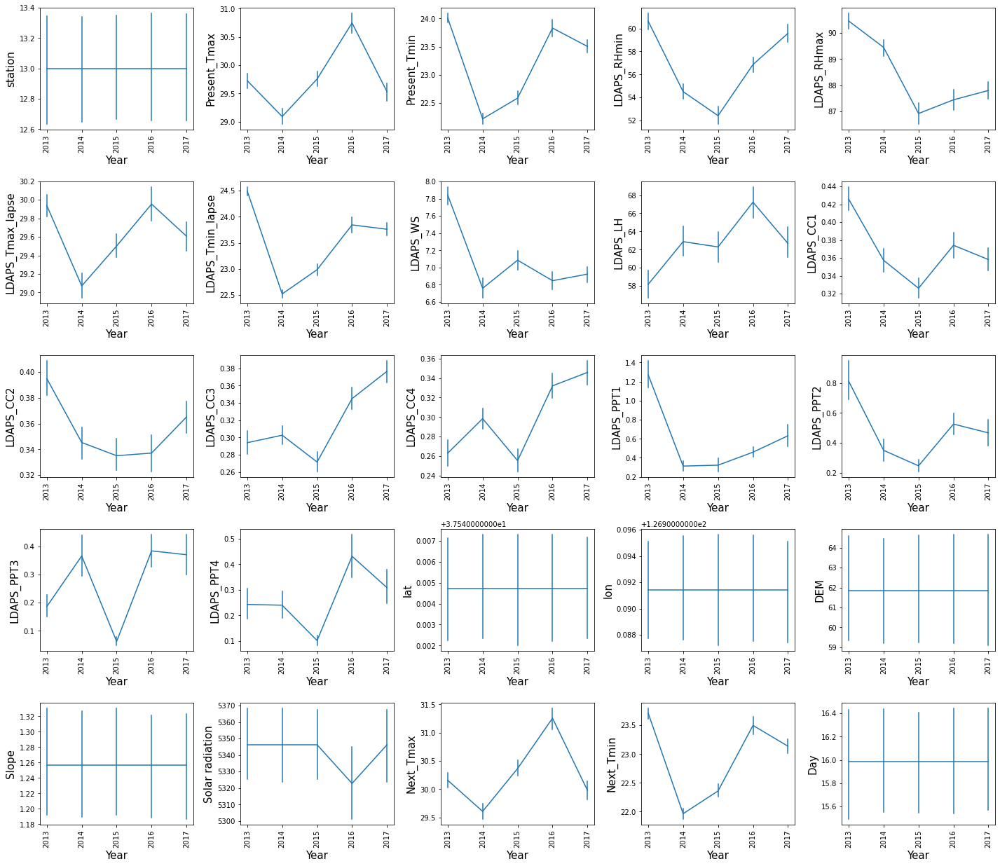

In [79]:

plt.figure(figsize=(20,20),facecolor='white')
plotnumber=1

for column in df:
    if plotnumber<=25:
        ax=plt.subplot(6,5,plotnumber)
        sns.lineplot(y=df[column], x=df['year'],err_style='bars')
        plt.xlabel('Year',fontsize=15)
        plt.ylabel(column,fontsize=15)
        plt.xticks(size=10,rotation=90)
    plotnumber+=1
plt.tight_layout()  

In [82]:
x=df.drop(columns=['Next_Tmax'],axis=1)
x=df.drop(columns=['Next_Tmin'],axis=1)
y=pd.DataFrame({})
y['Next_Tmax']=df['Next_Tmax']
y['Next_Tmin']=df['Next_Tmin']
y

,Next_Tmax,Next_Tmin
0,29.1,21.2
1,30.5,22.5
2,31.1,23.9
3,31.7,24.3
4,31.2,22.5
5,31.5,24.0
6,30.9,23.4
7,31.1,22.9
8,31.3,21.6
9,30.5,21.0


In [83]:
#Checking hw many are contributing to the output variables

#Checking for Multicollinearity
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif_data = pd.DataFrame()
vif_data["feature"] = x.columns


vif_data["VIF"] = [variance_inflation_factor(x.values, i)
                          for i in range(len(x.columns))]
print(vif_data)

             feature           VIF
0            station  5.214276e+00
1       Present_Tmax  2.997780e+02
2       Present_Tmin  3.099331e+02
3        LDAPS_RHmin  1.070330e+02
4        LDAPS_RHmax  3.510677e+02
5   LDAPS_Tmax_lapse  9.482954e+02
6   LDAPS_Tmin_lapse  7.500709e+02
7           LDAPS_WS  1.544026e+01
8           LDAPS_LH  6.990560e+00
9          LDAPS_CC1  1.066402e+01
10         LDAPS_CC2  1.541011e+01
11         LDAPS_CC3  1.398429e+01
12         LDAPS_CC4  7.224776e+00
13        LDAPS_PPT1  1.570828e+00
14        LDAPS_PPT2  1.591757e+00
15        LDAPS_PPT3  1.344309e+00
16        LDAPS_PPT4  1.348403e+00
17               lat  7.121781e+05
18               lon  1.668084e+06
19               DEM  8.513267e+00
20             Slope  5.675353e+00
21   Solar radiation  6.032439e+03
22         Next_Tmax  4.278540e+02
23               Day  4.106002e+01
24             month  6.250914e+03
25              year  1.295161e+06


In [92]:
#Scale the fetures
scaler=StandardScaler()
x_scaled=scaler.fit_transform(x)
x_scaled

array([[-1.66410059, -0.36085312, -0.7598684 , ...,  1.57165472,
        -2.76776074, -1.41421356],
       [-1.52542554,  0.71777446, -0.67681331, ...,  1.57165472,
        -2.76776074, -1.41421356],
       [-1.38675049,  0.61665312,  0.02915502, ...,  1.57165472,
        -2.76776074, -1.41421356],
       ...,
       [ 1.38675049, -2.18103715, -2.54555299, ...,  1.57165472,
         1.00369346,  1.41421356],
       [ 1.52542554, -2.18103715, -2.2963877 , ...,  1.57165472,
         1.00369346,  1.41421356],
       [ 1.66410059, -2.21474426, -2.42097035, ...,  1.57165472,
         1.00369346,  1.41421356]])

In [85]:
#Train the data to the model
x_train, x_test, y_train, y_test=train_test_split(x_scaled,y,test_size=0.25, random_state=100)

In [101]:
from sklearn.datasets import make_regression
from sklearn.linear_model import LinearRegression
x_scaled, y = make_regression(n_samples=7750, n_features=25, n_targets=2, random_state=1, noise=0.5)
# define model
model = LinearRegression()
# fit model
model.fit(x_train, y_train)
y_pred=model.predict(x_test)
reg_accuracy=metrics.r2_score(y_test,y_pred)
print(reg_accuracy)

0.9291827322071725


In [106]:
#Cross Validation
#from sklearn.model_selection import KFold,cross_val_score
from sklearn.model_selection import RepeatedKFold

k_f=RepeatedKFold(n_splits=5, n_repeats=2, random_state=1)
k_f

from sklearn.metrics import accuracy_score
k=5
acc_score = []

for train_index , test_index in k_f.split(x_scaled):
    x_train , x_test = x_scaled[train_index,:],x_scaled[test_index,:]
    y_train , y_test = y[train_index] , y[test_index]
     
    model.fit(x_train,y_train)
    pred_values = model.predict(x_test)
     
    acc = metrics.r2_score(y_test,pred_values)
    acc_score.append(acc)
     
avg_acc_score = sum(acc_score)/k
 
print('accuracy of each fold - {}'.format(acc_score))


accuracy of each fold - [0.9999929857507289, 0.9999931763166781, 0.9999933226195795, 0.99999301614107, 0.9999932266058216, 0.9999929933155626, 0.9999933496269207, 0.9999927586143795, 0.9999933653108177, 0.999993263967061]


### This shows that prediction of Tmin and Tmax values in 5 different split is arround 0.99 % which shows that theer is no overfitting

In [113]:
from sklearn.neighbors import KNeighborsRegressor
Knn = KNeighborsRegressor()
# fit model
Knn.fit(x_train, y_train)
y_pred=Knn.predict(x_test)
Knn_accuracy=metrics.r2_score(y_test,y_pred)
print(Knn_accuracy)

0.648465831166281


from sklearn.ensemble import GradientBoostingRegressor
gbdt_clf=GradientBoostingRegressor()
gbdt_clf.fit(x_train,y_train)
y_pred=gbdt_clf.predict(x_test)
gbdt_clf_accuracy=metrics.r2_score(y_test,y_pred)
gbdt_clf_accuracy
#### GradientBoostingRegressor, SVC not supporting multioutput regression values

In [114]:
with open("model", "wb") as f:
    pickle.dump(model, f)